In [1]:
using Pkg
#Pkg.activate("NB03")
Pkg.add("CSV")
Pkg.add("DataFrames")
Pkg.add("Graphs")
Pkg.add("GraphPlot")
Pkg.add("Colors")
Pkg.add("FileIO")
Pkg.add("LinearAlgebra")
Pkg.add("Plots")
Pkg.add("SparseArrays")
Pkg.add("VegaLite")
Pkg.add("JSON")
Pkg.add("VegaDatasets")
#TextParse = "e0df1984-e451-5cb5-8b61-797a481e67e3"
#VegaDatasets = "0ae4a718-28b7-58ec-9efb-cded64d6d5b4"
#VegaLite = "112f6efa-9a02-5b7d-90c0-432ed331239a"
#WeakRefStrings = "ea10d353-3f73-51f8-a26c-33c1cb351aa5"

#Pkg.add("TextParse")
#Pkg.add("WeakRefStrings")
#Pkg.add("VegaDatasets")
Pkg.resolve()
Pkg.instantiate()

    Updating registry at `~/.julia/registries/General.toml`
   Resolving package versions...
   Installed Qt5Base_jll ─ v5.15.3+2
  No Changes to `~/.julia/environments/v1.8/Project.toml`
    Updating `~/.julia/environments/v1.8/Manifest.toml`
  [ea2cea3b] ↑ Qt5Base_jll v5.15.3+1 ⇒ v5.15.3+2
Precompiling project...
  ✓ Qt5Base_jll
  ✓ GR_jll
  ✓ GR
  ✓ Plots
  ✓ StatsPlots
  5 dependencies successfully precompiled in 30 seconds. 214 already precompiled.
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
  No Changes to `~/.julia/environments/v1.8/Manifest.toml`
   Resolving package versions...
  No Changes to `~/.julia/environments/v1.8/Project.toml`
 

In [2]:
using CSV, JSON
using DataFrames, Graphs, GraphPlot, Colors
using SparseArrays, LinearAlgebra, Plots, FileIO
using VegaLite, VegaDatasets
#using VegaDatasets

This notebook is partially based on the Juila acadamy [DataScience](https://github.com/JuliaAcademy/DataScience) course of [Huda Nassar](https://github.com/nassarhuda). 

---
---
# Loading the Data

We load the data set `flights-airport`:

In [44]:
#flights = dataset("flights-airport.csv") |> DataFrame;
flights= CSV.read("flights-airport.csv", DataFrame)

Row,origin,destination,count
,String3,String3,Int64
1,ABE,ATL,853
2,ABE,BHM,1
3,ABE,CLE,805
4,ABE,CLT,465
5,ABE,CVG,247
6,ABE,DTW,997
7,ABE,JFK,3
8,ABE,LGA,9
9,ABE,ORD,1425


The first 8 lines of these `DataFrames` are as follows:

In [45]:
flights[1:8,:]

Row,origin,destination,count
,String3,String3,Int64
1,ABE,ATL,853
2,ABE,BHM,1
3,ABE,CLE,805
4,ABE,CLT,465
5,ABE,CVG,247
6,ABE,DTW,997
7,ABE,JFK,3
8,ABE,LGA,9


We extract the Airport IDs in an array `airports`.

In [46]:
list_airports = vcat(flights[:,:origin],flights[:,:destination])
airports = unique(list_airports)
airports[1:5]
length(airports)

305

---
---
# Definition of the Graph

Next we compute the Adjacency matrix `A`.

In [47]:
# build the adjacency matrix
n = length(airports)
A = spzeros(n,n)
for k = 1:size(flights, 1)
    i = findfirst(airports .== flights[k,:origin])
    j = findfirst(airports .== flights[k,:destination])
    A[i,j] = 1
end
A = max.(A,A')

305×305 SparseMatrixCSC{Float64, Int64} with 5668 stored entries:
⠀⠀⣾⠀⠁⡂⡂⠄⡋⢚⢚⣊⢒⢀⠀⠀⠀⢒⠀⢸⡒⡍⠐⣒⠈⠠⡒⢚⢚⠀⠀⠀⠐⡰⠰⠖⠀⡒⠀⠀
⠚⠛⢾⠓⠲⡚⡖⠓⠖⢺⢻⢻⢺⡶⠂⠗⠒⠿⠖⣺⣿⠖⠒⠶⠶⡚⡟⠻⢿⠒⠰⠗⢞⢛⢺⡒⠲⠞⠒⠆
⠡⠠⣸⠢⠪⠂⢧⠰⠷⢺⢹⠸⢸⠰⠲⠢⠁⣻⠄⠸⠷⠇⠒⢿⠾⠀⡷⢻⠾⠇⠸⠷⠴⡸⢺⠸⠤⠇⠂⠁
⠈⠌⢼⠉⢉⡓⠁⠀⡉⢸⢹⣸⢘⡘⠀⠈⠂⢹⡋⢉⠻⡋⠈⢻⢉⢀⡋⢹⠉⠉⠉⠉⢋⢸⠼⠉⠐⠋⠀⠆
⣫⢈⣸⣁⣹⣃⣃⣈⣏⣹⣹⣹⣘⢍⡀⣚⠀⣼⡇⣘⣿⣯⢸⣻⣻⢈⡏⣿⣻⡍⢌⣋⣫⣨⣸⣝⢙⣋⣁⡄
⡺⢰⣿⣒⣓⡒⣓⣲⣗⣺⣺⣺⣛⢒⡒⣖⠒⣻⣂⣒⣻⣿⢚⣳⣺⢲⡗⣿⣲⡒⢒⣖⣚⣐⣲⢚⣐⣛⡒⡒
⠘⢐⢺⡶⢒⡒⣒⠰⡖⢜⢻⢘⢄⠑⠀⡒⠐⣛⣂⢒⣿⡖⢰⣚⣳⠰⣆⢿⢻⣃⣖⣓⡺⢾⢸⢺⢒⡚⠆⠦
⠀⠀⢬⠄⠸⡂⡀⠀⣠⢨⢸⢬⢠⠠⠄⠁⠤⢠⠀⢀⠳⡃⠀⣩⣨⠨⡗⢾⢺⠄⠄⡖⠑⠸⠹⠂⠀⠽⠀⠄
⢠⢀⣼⡄⣥⣠⣌⣀⣀⣤⣼⣠⣴⢠⠀⣃⢀⣴⡀⣼⣤⣢⣠⣤⣀⡀⣧⣼⣤⣄⣀⣀⣤⢠⣸⣤⣀⣤⣀⡀
⣀⣀⣸⣡⣀⡁⡏⢈⣉⢩⢨⢸⢨⢘⠀⢀⣀⣬⡄⣩⣻⣁⢉⣿⡉⠀⣧⣩⣊⡁⣄⣁⣋⢈⣩⣈⣀⣃⡀⡃
⡜⠬⢻⠟⠽⠇⡿⠢⡿⣿⣿⣾⢻⠿⠽⠢⠠⣻⠟⢺⣎⠝⢘⣿⡿⠺⣿⣿⣿⠇⠋⠿⢿⢻⢻⣿⠄⠿⠬⠇
⢰⢠⢸⡄⣼⣄⣦⣀⣶⣲⢾⣰⣰⢲⡄⣠⠀⣾⣧⣴⣶⣴⢠⡶⣶⣐⣗⣾⣶⣦⢤⣦⣶⢰⣸⣲⠠⣶⣆⡀
⠂⡀⣸⠣⠚⠃⠃⢐⡛⢚⢺⣚⢙⡚⡂⡚⠀⠸⠃⠈⣻⡋⢘⢻⢔⠑⡇⣾⣙⡃⠈⣫⢛⣹⢘⠘⠁⢓⠁⠁
⣸⢈⣿⡉⣽⣋⣏⣈⣯⣭⣽⣭⣬⣝⣹⣍⣉⣿⡍⣻⣿⣿⣹⣽⣩⣭⣵⣿⣿⣁⣍⣹⣹⣹⣹⣯⣈⣹⣁⡁
⠚⠐⢻⠓⠾⠇⡇⠀⡟⠾⢸⠺⠿⢲⠚⠖⠀⢿⠎⠸⠿⠟⠸⣿⠷⠸⠟⢻⠾⠃⠓⠻⠟⢺⢼⠓⠚⡗⡀⠂
⠀⠀⢴⠆⢶⡆⡇⠀⡦⢱⢸⢴⢼⢹⢠⠥⠀⢸⠄⢹⣯⡄⠠⣷⡦⣠⣇⣹⣽⡀⠀⡠⢰⢸⢹⡢⠀⢎⠋⠄
⢐⡠⣾⢑⣐⡣⣋⣐⡋⣺⢚⢸⣺⣎⣑⡀⠀⣛⡋⢘⣿⣓⢘⣛⣟⣰⣗⣺⣻⣁⣐⣒⢰⣲⣰⣚⠀⣓⡀⠀
⢰⠆⢺⠲⣚⡒⡖⠃⣖⢾⣸⢚⣲⣒⠳⠂⠒⣾⡃⢺⣿⣶⢲⣺⣒⠐⡷⣾⢶⠓⠳⡲⣰⢺⣺⣾⠂⣲⠗⠓
⢠⠠⣸⠆⠤⠇⡴⠀⡷⢰⣴⢸⣸⠰⣄⡄⠀⣼⠤⢸⣤⡅⢠⣦⢥⢀⣆⣸⢾⠤⡠⢄⢤⢠⢨⣠⠠⠆⠁⡀
⠀⠀⠸⠄⠌⠀⠠⠄⠁⠼⢸⠨⠨⡅⠀⠄⠀⠸⠤⠨⠦⠇⠈⠹⠅⠀⠅⠸⠠⠈⠋⠄⠀⠈⢽⠁⠁⠠⠀⠀

The graph `G` is defined by the matrix `A`.

In [48]:
G = Graph(A)

{305, 2834} undirected simple Int64 graph

---
---
# Visualization

We look at a visualization of the graph.

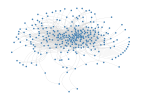

In [49]:
layout= x -> spring_layout(x; C=5)
gplot(G, layout = layout,
        nodefillc = colorant"steelblue",
        linetype="curve"
)

It seems that the distribution of degrees of the blue nodes is not even. This is confirmed by the following plots.

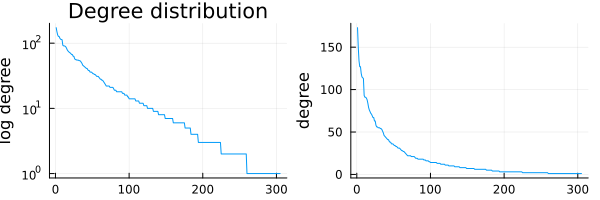

In [50]:
degrees = degree(G)
p1 = plot(sort(degrees,rev=true), ylabel="log degree", legend=false, yaxis=:log, title="Degree distribution")
p2 = plot(sort(degrees,rev=true), ylabel="degree", legend=false)
plot(p1, p2, size=(600,200))

---
---
# Geographical Visualization

The first visualization lookd at `G` as a graph without any further structure.

The vertices in `G` can be identified with points in $\mathbb R^2$.

We can represent this structure visually as follows.

First we load a data set providing the lattitude and longitude of the airports.

In [51]:
#all_locations = dataset("airports") |> DataFrame
all_locations = CSV.read("airports.csv", DataFrame)
k = [id in airports for id in all_locations[:,:iata]]
locations = all_locations[k,:]
locations[1:5,:]

Row,iata,name,city,state,country,latitude,longitude
,String7,String,String,String3,String31,Float64,Float64
1,ABE,Lehigh Valley International,Allentown,PA,USA,40.6524,-75.4404
2,ABI,Abilene Regional,Abilene,TX,USA,32.4113,-99.6819
3,ABQ,Albuquerque International,Albuquerque,NM,USA,35.0402,-106.609
4,ABY,Southwest Georgia Regional,Albany,GA,USA,31.5355,-84.1945
5,ACK,Nantucket Memorial,Nantucket,MA,USA,41.2531,-70.0602


With the help of the package `VegaLite` we can visualize the graph:

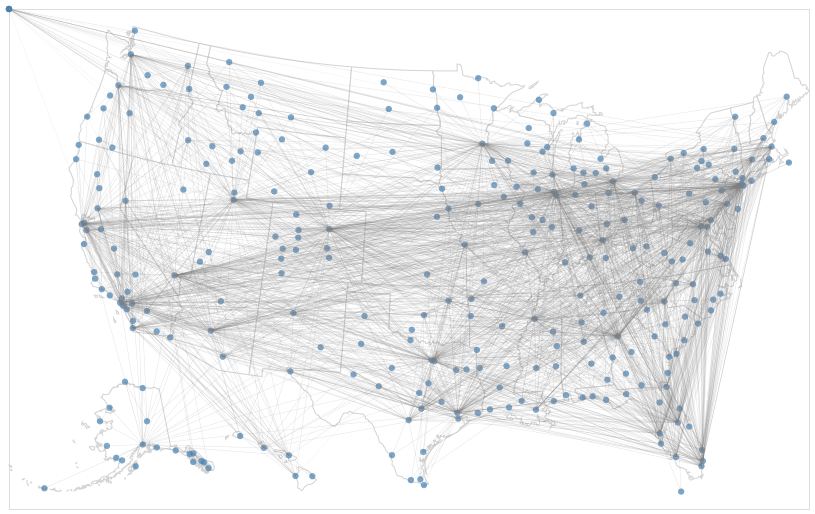

In [68]:
us10m = dataset("us-10m")


P1 = @vlplot(width=800, height=500) +
@vlplot(
    mark={:geoshape, fill=:white, stroke=:lightgray},
    data={values=us10m, format={type=:topojson,feature=:states}},
    projection={type=:albersUsa}) +
@vlplot(
    :circle,
    data=locations, projection={type=:albersUsa}, 
    longitude="longitude:q", latitude="latitude:q", 
    size={value=40}, color={value=:steelblue})+
@vlplot(
    mark={:rule, strokeWidth = 0.5, opacity=0.1,  color = "grey"},
    data=flights, 
         transform=[
                {lookup=:origin, 
                 from={data=locations, key=:iata, fields=["latitude", "longitude"]},
                 as=["origin_latitude", "origin_longitude"]},
                {lookup=:destination,
                 from={data=locations, key=:iata, fields=["latitude", "longitude"]},
                 as=["dest_latitude", "dest_longitude"]}],
        projection={type=:albersUsa},
        longitude="origin_longitude:q", latitude="origin_latitude:q",
        longitude2="dest_longitude:q", latitude2="dest_latitude:q")

---
---
# Computing PageRank

We compute the PageRank of each airport in our network $G=(V,E)$.

Recall: the PageRank distribution is given by the Eigenvector of eigenvalue 1 or the matrix
$$ P = (p_{u,v})\in \mathbb R^{\vert V\vert \times \vert V\vert} , \quad p_{u,v}=\begin{cases} 1/\mathrm{deg}(v), & \{u,v\}\in E\\ 0, &\text{sonst}\end{cases}.
$$


We first define $P$.

In [20]:
P = zeros(n, n);
for u in 1:n
    for v in 1:n
        if A[u,v] == 1
            P[u,v] = 1/degrees[v]
        end
    end
end

Then we compute its eigenvectors

In [21]:
E = eigen(P)
E.values[end-2:end]

3-element Vector{ComplexF64}:
 0.7031739565313231 + 0.0im
 0.8326686588085682 + 0.0im
                1.0 + 0.0im

The desired eigenvector is the last element of `E.vector`.

In [22]:
f = real.(E.vectors[:,end])
# test:
norm(P*f-f)

1.0496591891260166e-15

For PageRank we make a new data frame `DataFrame`:

In [23]:
PageRank =  DataFrame(airport = locations[:,:name], 
                      city = locations[:,:city],  
                      rank = f ./ sum(f),
                      longitude = locations[:,:longitude],
                      latitude = locations[:,:latitude]
)
PageRank[1:5,:]

Row,airport,city,rank,longitude,latitude
,String,String,Float64,Float64,Float64
1,Lehigh Valley International,Allentown,0.00211715,-75.4404,40.6524
2,Abilene Regional,Abilene,0.000352858,-99.6819,32.4113
3,Albuquerque International,Albuquerque,0.00723359,-106.609,35.0402
4,Southwest Georgia Regional,Albany,0.000176429,-84.1945,31.5355
5,Nantucket Memorial,Nantucket,0.000529287,-70.0602,41.2531


We now look at which aiports have the highes page ranks.

In [24]:
PageRank_sorted = sort(PageRank,[:rank],rev=true)
PageRank_sorted[1:5,:]

Row,airport,city,rank,longitude,latitude
,String,String,Float64,Float64,Float64
1,William B Hartsfield-Atlanta Intl,Atlanta,0.0305222,-84.4269,33.6404
2,Nome,Nome,0.0264644,-165.445,64.5122
3,Denver Intl,Denver,0.0236415,-104.667,39.8584
4,Missoula International,Missoula,0.0224065,-114.091,46.9163
5,Ronald Reagan Washington National,Arlington,0.0224065,-77.0377,38.8521


---
---
# Visualization


We can now visualize the graph as before, but scale the vertices according to their page rank.

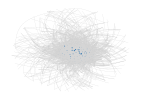

In [25]:
layout= x -> spring_layout(x; C=20)
gplot(G, layout = layout,
        nodefillc = colorant"steelblue",
        linetype = "curve",
        nodesize = PageRank[:,:rank]
)

We can se that the pagerank is concentrated on a few airports.

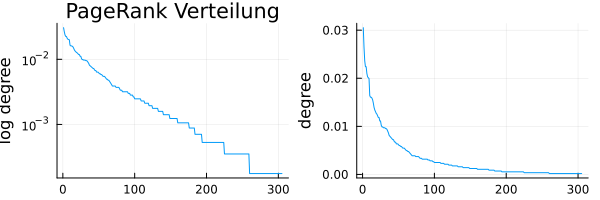

In [26]:
p1 = plot(PageRank_sorted[:,:rank], ylabel="log degree", legend=false, yaxis=:log, title="PageRank Distribution")
p2 = plot(PageRank_sorted[:,:rank], ylabel="degree", legend=false)
plot(p1, p2, size=(600,200))

The second visualization is as follows:

WARN Channel size should not be used with an unsorted discrete field.
WARN Channel size should not be used with an unsorted discrete field.


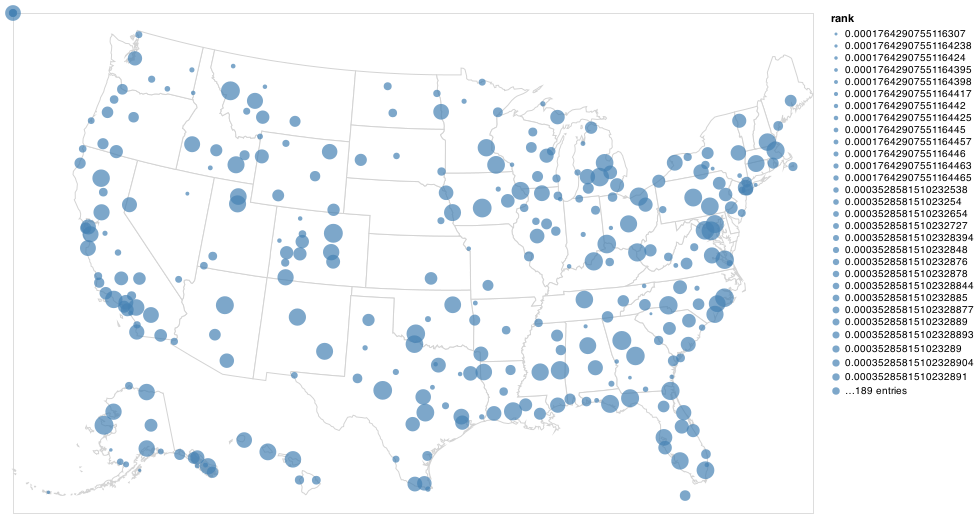

In [27]:
P2 = @vlplot(width=800, height=500) +
@vlplot(
    mark={:geoshape, fill=:white, stroke=:lightgray},
    data={values=us10m, format={type=:topojson,feature=:states}},
    projection={type=:albersUsa}) +
@vlplot(
    :circle,
    data=PageRank, projection={type=:albersUsa}, 
    longitude="longitude:q", latitude="latitude:q", 
    size="rank", color={value=:steelblue})

---
---
# Markov Process
We want to approximate PageRank using a Markov process.

To do this, we first sample a random airport `X`.

In [28]:
X = rand(1:n)
locations[X,:name]

"Greenbrier Valley"

From `X` we want to go to another airport.

The random distribution is determined by the column of `P` that belongs to `X`.

In [29]:
sum(P[:,X])

1.0

We select airport `Y` with probability `P[Y,X]`.

To do this, we define a function that executes this random selection.

In [30]:
function step(X, P)
    F = cumsum(P[:,X])
    r = rand()
    findfirst(F .> r)
end

step (generic function with 1 method)

A 10-step random process can then be performed as follows:

In [31]:
ℓ = 10
walk = zeros(Int, ℓ)
walk[1] = X
for i in 2:ℓ
    walk[i] = step(walk[i-1], P)
end
locations[walk, :name]

10-element Vector{String}:
 "Greenbrier Valley"
 "San Angelo Regional /Mathis"
 "Rapid City Regional"
 "Gillette-Campbell County"
 "Newport News/Williamsburg International"
 "Duluth International"
 "Ronald Reagan Washington National"
 "University Park"
 "Salt Lake City Intl"
 "Jacksonville International"

Each random process with $\ell$ steps defines a random distribution on $G$. 

We define a function that draws from this distribution:

In [32]:
function sample(ℓ, P)
    X = rand(1:n)
    for i in 2:ℓ
        X = step(X, P)
    end
   X
end

sample (generic function with 1 method)

and sample an airport from this distribution:

In [33]:
X = sample(1000, P)
locations[X, :name]

"Daytona Beach International"

we now have a method to generate random objects whose distribution is close to the PageRank distribution. In this way we can approximate PageRank without calculating eigenvalues!

In [34]:
Ω = [sample(20, P) for _ in 1:1e4];
p = [count(Ω .== i) for i in 1:n]
PageRankApprox =  DataFrame(airport = locations[:, :name], 
                      city = locations[:, :city],  
                      rank =  p./sum(p),
                      longitude = locations[:, :longitude] .+ 0.5, #zur Visualisuerung
                      latitude = locations[:, :latitude] .+ 0.5
)
PageRankApprox[1:5,:]

Row,airport,city,rank,longitude,latitude
,String,String,Float64,Float64,Float64
1,Lehigh Valley International,Allentown,0.002,-74.9404,41.1524
2,Abilene Regional,Abilene,0.0005,-99.1819,32.9113
3,Albuquerque International,Albuquerque,0.0092,-106.109,35.5402
4,Southwest Georgia Regional,Albany,0.0003,-83.6945,32.0355
5,Nantucket Memorial,Nantucket,0.0008,-69.5602,41.7531


Here is a visualization of our approximation (PageRank in blue, Approximation brown):

WARN Channel size should not be used with an unsorted discrete field.
WARN Channel size should not be used with an unsorted discrete field.
WARN Channel size should not be used with an unsorted discrete field.
WARN Channel size should not be used with an unsorted discrete field.


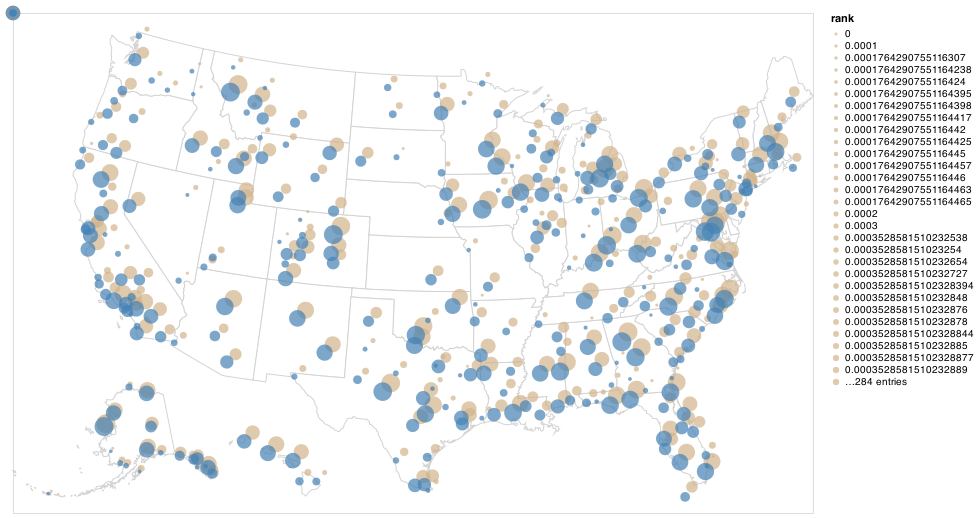

In [35]:
@vlplot(width=800, height=500) +
@vlplot(
    mark={:geoshape, fill=:white, stroke=:lightgray},
    data={values=us10m, format={type=:topojson,feature=:states}},
    projection={type=:albersUsa}) +
@vlplot(
    :circle,
    data=PageRankApprox, projection={type=:albersUsa}, 
    longitude="longitude:q", latitude="latitude:q", 
    size="rank", color={value=:tan}) +
@vlplot(
    :circle,
    data=PageRank, projection={type=:albersUsa}, 
    longitude="longitude:q", latitude="latitude:q", 
    size="rank", color={value=:steelblue})

Finally, we plot Page-Rank against the approximated Page-Rank.

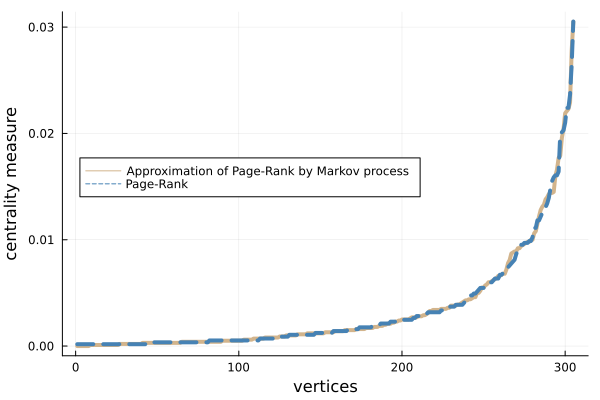

In [36]:
plot(sort(PageRankApprox[:,"rank"]), 
                    linewidth = 4, 
                    color = :tan,
                    label = "Approximation of Page-Rank by Markov process",
                    legend = :left,
                    xlabel = "vertices",
                    ylabel = "centrality measure")
plot!(sort(PageRank[:,"rank"]), 
                    linewidth = 4, 
                    color = :steelblue,
                    label = "Page-Rank",
                    linestyle = :dash)

---
# Metropolis-Hastings

For $u\in V$ let $f(u)$ be the number of flight connected to and from $u$.


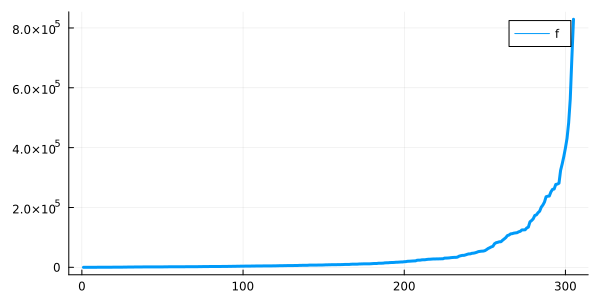

In [37]:
f = zeros(n)
for k = 1:n
    i = findall(flights[:,:origin] .== airports[k])
    f[k] += sum(flights[i, :count])
    j = findall(flights[:,:destination] .== airports[k])
    f[k] += sum(flights[j, :count])
end
plot(sort(f), label = "f", lw = 3, size = (600,300))

We want to use the Metropolis-Hastings algorithm to sample the probability distribution
$$\pi(u) = \frac{f(u)}{\sum_{v\in V} f(v)},\quad v\in V.$$

We call the transition matrix for the algorithm `Q`:

$$q_{uv}=
\begin{cases}
\tfrac{1}{d}\min\{1, \tfrac{\pi(u)}{\pi(v)}\}, &\text{ if } u\neq v\text{ and }\{u,v\}\in E\\
0, &\text{ if } u\neq v\text{ and } \{u,v\}\not\in E\\
1- \sum_{i\neq v} q_{iv}, &\text{ if } u=v.
\end{cases}$$

with $d>\max_{v\in V}\mathrm{deg}(v)$.

In [38]:
d = maximum(degrees)+1
Q = (1/d) .* [A[u,v] .* min(1, f[u]/f[v]) for (u,v) in Iterators.product(1:n,1:n)]
Q = Q + diagm(ones(n) - Q' * ones(n));

Now we can start the algorithm. We use 2000 steps and sample $10^3$ times.

In [39]:
Ω₂ = [sample(2000, Q) for _ in 1:1e3];
q = [count(Ω₂  .== i) for i in 1:n]
Count = DataFrame(airport = locations[:, :name], 
                      city = locations[:, :city],  
                      rank =  q./sum(q),
                      longitude = locations[:, :longitude],
                      latitude = locations[:, :latitude])
Count[1:5,:]

Row,airport,city,rank,longitude,latitude
,String,String,Float64,Float64,Float64
1,Lehigh Valley International,Allentown,0.0,-75.4404,40.6524
2,Abilene Regional,Abilene,0.001,-99.6819,32.4113
3,Albuquerque International,Albuquerque,0.005,-106.609,35.0402
4,Southwest Georgia Regional,Albany,0.0,-84.1945,31.5355
5,Nantucket Memorial,Nantucket,0.0,-70.0602,41.2531


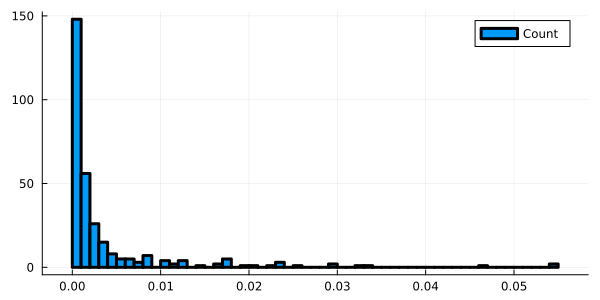

In [40]:
histogram(Count[:, :rank], label = "Count", lw = 3, size = (600,300))

WARN Channel size should not be used with an unsorted discrete field.
WARN Channel size should not be used with an unsorted discrete field.


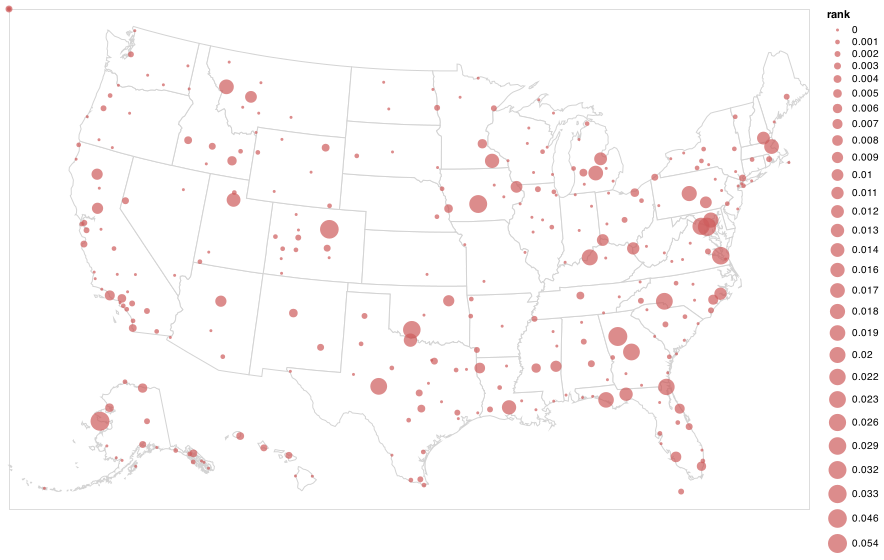

In [41]:
@vlplot(width=800, height=500) +
@vlplot(
    mark={:geoshape, fill=:white, stroke=:lightgray},
    data={values=us10m, format={type=:topojson,feature=:states}},
    projection={type=:albersUsa}) +
@vlplot(
    :circle,
    data=Count, projection={type=:albersUsa}, 
    longitude="longitude:q", latitude="latitude:q", 
    size="rank", color={value=:indianred})